# Understanding the Problem Statement

<b> Problem Statement</b> :  <br>
Automobile accidents are very common in nature and requires good amount of assessment from Adjustors to define the associated loss with the claim. Additionally loss ratio is a key factor that drives the insurance company. Objective of this problem statement is to predict claims loss amount so that insurance company can keep a check on premium pricing and overall loss ratio. <br> <br>

<b> Key Metrics</b> :  RMSE value <br> <br>
    

<b> Features :</b> <br>

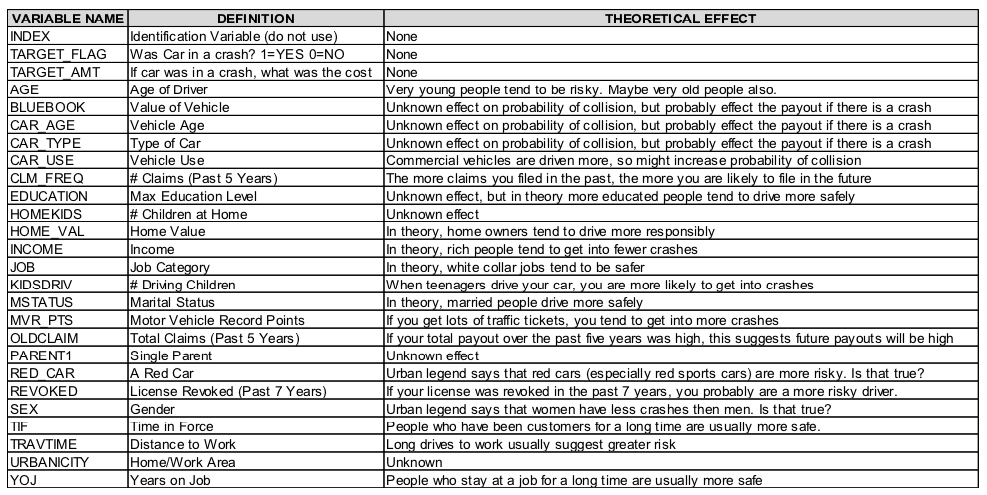

### 1. Importing libraries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# To ignore warnings
import warnings
warnings.filterwarnings("ignore")

from sklearn.model_selection import train_test_split

C:\Users\vdwivedi\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [53]:
from pandas_profiling import ProfileReport

## User Defined Functions:-

#### 1. Inspecting data details for a dataframe

In [1]:
# Information of variables for data set:
def inspect_data(data):
    data_details =  pd.DataFrame({"Data Type":data.dtypes,
                         "Count of Blank Values":data.apply(lambda x: x.isin([' ']).sum(),axis=0),          
                        "Count of Missing Values":data.apply(lambda x: x.isnull().sum(),axis=0),
                         "% of Missing Values":data.apply(lambda x: round(x.isnull().sum()/len(x.index)*100,2),axis=0),
                        "No of Unique Data":data.apply(lambda x: x.nunique(),axis=0),
                         "Levels":data.apply(lambda x: str(x.unique()),axis=0)
                        })
    return data_details#### 2. Finding numeric and categorical column details

#### 2. Finding numeric and categorical column details

In [2]:
def col_type(df):
    category='object'
    catcols=df.select_dtypes(include=category).columns
    numcols=df.select_dtypes(exclude=category).columns
    return catcols,numcols

##################################################
# Example :-
#cat_cols=col_type(df)[0]
#num_cols=col_type(df)[1]
#cat_cols
#num_cols

#### 3.  Generating catplot with 1 categorical variable and 1 target categorical variable for entire dataframe

In [3]:
def catcol_plot(df,target):
    cols=col_type(df)
    cat_cols=cols[0]
    colrefs=list(df[cat_cols].columns)
    colrefs.remove(target)
    #remove customerid/index details
    colrefs=colrefs[1:]
    for col in colrefs:
        #print(col)
        plt.figure(figsize = (8,6))
        plt.subplot(1,1,1)
        sns.countplot(x=col,data=df,hue=target).set_title(col + " vs" + target)
        
        
#######################################################
## Example for function call
## catcol_plot(tel,'Churn')
## Churn is your target variable
## tel is your dataframe details

#### 4. Generating scatterplot with 1 numerical variable and 1 target numerical variable for entire dataframe


In [4]:
def numcol_plot(df,target):
    cols=col_type(df)
    num_cols=cols[1]
    colrefs=list(df[num_cols].columns)
    colrefs.remove(target)
    #remove customerid/index details
    colrefs=colrefs[1:]
    for col in colrefs:
        #print(col)
        plt.figure(figsize = (8,6))
        plt.subplot(1,1,1)
        sns.scatterplot(x=col,data=df,y=target).set_title(col + " vs " + target)
        plt.legend(loc='upper center', bbox_to_anchor=(1, 0.8))
        plt.xticks(rotation=65, horizontalalignment='right',fontweight='light')

#### 5. Defining method to clean currencies

In [33]:
def clean_currency(x):
    """ If the value is a string, then remove currency symbol and delimiters
    otherwise, the value is numeric and can be converted
    """
    if isinstance(x, str):
        return(x.replace('$', '').replace(',', ''))
    return(x)

#### 6. Generating bar chart for categorical columns vs numerical target

In [47]:
def barCat_plot(df,target):
    cols=col_type(df)
    cat_cols=cols[0]
    colrefs=list(df[cat_cols].columns)
    #colrefs.remove(target)
    #remove customerid/index details
    #colrefs=colrefs[1:]
    for col in colrefs:
        #print(col)
        plt.figure(figsize = (8,6))
        plt.subplot(1,1,1)
        sns.barplot(x=col,data=df,y=target).set_title(col + " vs " + target)
        plt.legend(loc='upper center', bbox_to_anchor=(1, 0.8))
        plt.xticks(rotation=65, horizontalalignment='right',fontweight='light')

## 1. Reading and understanding the Data

In [3]:
carins=pd.read_csv("car_insurance_claim.csv")

In [7]:
carins[['KIDSDRIV','BIRTH']][1:3]

,KIDSDRIV,BIRTH
1,0,21-Jan-56
2,0,18-Nov-51


In [10]:
carins.head(2)

,ID,KIDSDRIV,BIRTH,AGE,HOMEKIDS,YOJ,INCOME,PARENT1,HOME_VAL,MSTATUS,...,CAR_TYPE,RED_CAR,OLDCLAIM,CLM_FREQ,REVOKED,MVR_PTS,CLM_AMT,CAR_AGE,CLAIM_FLAG,URBANICITY
0,63581743,0,16-Mar-39,60.0,0,11.0,"$67,349",No,$0,z_No,...,Minivan,yes,"$4,461",2,No,3,$0,18.0,0,Highly Urban/ Urban
1,132761049,0,21-Jan-56,43.0,0,11.0,"$91,449",No,"$257,252",z_No,...,Minivan,yes,$0,0,No,0,$0,1.0,0,Highly Urban/ Urban


In [11]:
carins.shape

(10302, 27)

In [23]:
carins.describe(include='all')

,ID,KIDSDRIV,BIRTH,AGE,HOMEKIDS,YOJ,INCOME,PARENT1,HOME_VAL,MSTATUS,...,CAR_TYPE,RED_CAR,OLDCLAIM,CLM_FREQ,REVOKED,MVR_PTS,CLM_AMT,CAR_AGE,CLAIM_FLAG,URBANICITY
count,1.030200e+04,10302.000000,10302,10295.000000,10302.000000,9754.000000,9732,10302,9727,10302,...,10302,10302,10302,10302.000000,10302,10302.000000,10302,9663.000000,10302.000000,10302
unique,NaN,NaN,6560,NaN,NaN,NaN,8151,2,6334,2,...,6,2,3545,NaN,2,NaN,2346,NaN,NaN,2
top,NaN,NaN,20-Oct-60,NaN,NaN,NaN,$0,No,$0,Yes,...,z_SUV,no,$0,NaN,No,NaN,$0,NaN,NaN,Highly Urban/ Urban
freq,NaN,NaN,8,NaN,NaN,NaN,797,8959,2908,6188,...,2883,7326,6292,NaN,9041,NaN,7556,NaN,NaN,8230
mean,4.956631e+08,0.169288,NaN,44.837397,0.720443,10.474062,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.800718,NaN,1.710153,NaN,8.298148,0.266550,NaN
std,2.864675e+08,0.506512,NaN,8.606445,1.116323,4.108943,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.154079,NaN,2.159015,NaN,5.714450,0.442177,NaN
min,6.317500e+04,0.000000,NaN,16.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.000000,NaN,0.000000,NaN,-3.000000,0.000000,NaN
25%,2.442869e+08,0.000000,NaN,39.000000,0.000000,9.000000,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.000000,NaN,0.000000,NaN,1.000000,0.000000,NaN
50%,4.970043e+08,0.000000,NaN,45.000000,0.000000,11.000000,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.000000,NaN,1.000000,NaN,8.000000,0.000000,NaN
75%,7.394551e+08,0.000000,NaN,51.000000,1.000000,13.000000,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,2.000000,NaN,3.000000,NaN,12.000000,1.000000,NaN


In [13]:
#using user defined function to understand the data variation across each field
inspect_data(carins)

,Data Type,Count of Blank Values,Count of Missing Values,% of Missing Values,No of Unique Data,Levels
ID,int64,0,0,0.00,8753,[63581743 132761049 921317019 ... 67790126 849...
KIDSDRIV,int64,0,0,0.00,5,[0 1 2 3 4]
BIRTH,object,0,0,0.00,6560,['16-Mar-39' '21-Jan-56' '18-Nov-51' ... '13-A...
AGE,float64,0,7,0.07,61,[60.0 43.0 48.0 35.0 51.0 50.0 34.0 54.0 40.0 ...
HOMEKIDS,int64,0,0,0.00,6,[0 1 2 3 4 5]
YOJ,float64,0,548,5.32,21,[11.0 10.0 14.0 nan 12.0 7.0 5.0 0.0 13.0 9.0 ...
INCOME,object,0,570,5.53,8151,"['$67,349 ' '$91,449 ' '$52,881 ' ... '$164,66..."
PARENT1,object,0,0,0.00,2,['No' 'Yes']
HOME_VAL,object,0,575,5.58,6334,"['$0 ' '$257,252 ' '$124,191 ' ... '$332,591 '..."
MSTATUS,object,0,0,0.00,2,['z_No' 'Yes']


1. KIDSDRIV has only 5 unique values and hence it needs to get converted to Object type
2. 'Income' has 8151 unique values and has to be converted to float
3. 'HOME_VAL' to be converted to int
4. BLUEBOOK - to be converted to int
5. OLDCLAIM - to be converted to int
6. CLM_AMT - target variable needs to be converted to float

In [15]:
#Applying pandas profiling to understand data details
profile = ProfileReport(carins, title="Pandas Profiling Report")
profile.to_notebook_iframe()

In [9]:
profile.to_widgets()

In [11]:
import sweetviz as sv

In [13]:
my_report = sv.analyze(carins)
my_report.show_html()

:FEATURES DONE:                    |                     | [  0%]   00:05  -> (00:00 left)
:PAIRWISE DONE:                    |█████████████████████| [100%]   00:03  -> (00:00 left)


Creating Associations graph... DONE!


In [14]:
# Building same analysis using quickda
import os
from quickda.explore_data import *
from quickda.clean_data import *
from quickda.explore_numeric import *
from quickda.explore_categoric import *
from quickda.explore_numeric_categoric import *
from quickda.explore_time_series import *

In [15]:
explore(carins)

Calculating dtypes...
Calculating count...
Calculating null_sum...
Calculating null_pct...
Calculating nunique...
Calculating min...
Calculating 25%...
Calculating 50%...
Calculating 75%...
Calculating max...
Calculating mean...
Calculating median...
Calculating std...
Calculating skew...


,dtypes,count,null_sum,null_pct,nunique,min,25%,50%,75%,max,mean,median,std,skew
AGE,float64,10295,7,0.001,61,16,39,45,51,81,44.8374,45,8.60645,-0.0345407
BIRTH,object,10302,0,0.000,6560,1-Apr-39,-,-,-,9-Sep-72,-,-,-,-
BLUEBOOK,object,10302,0,0.000,2985,"$1,500",-,-,-,"$9,990",-,-,-,-
CAR_AGE,float64,9663,639,0.062,30,-3,1,8,12,28,8.29815,8,5.71445,0.280461
CAR_TYPE,object,10302,0,0.000,6,Minivan,-,-,-,z_SUV,-,-,-,-
CAR_USE,object,10302,0,0.000,2,Commercial,-,-,-,Private,-,-,-,-
CLAIM_FLAG,int64,10302,0,0.000,2,0,0,0,1,1,0.26655,0,0.442177,1.05612
CLM_AMT,object,10302,0,0.000,2346,$0,-,-,-,$991,-,-,-,-
CLM_FREQ,int64,10302,0,0.000,6,0,0,0,2,5,0.800718,0,1.15408,1.19406
EDUCATION,object,10302,0,0.000,5,<High School,-,-,-,z_High School,-,-,-,-


In [16]:
explore(carins, method='profile', report_name='Cars Dataset Report')

In [16]:
carins.head()

,ID,KIDSDRIV,BIRTH,AGE,HOMEKIDS,YOJ,INCOME,PARENT1,HOME_VAL,MSTATUS,...,CAR_TYPE,RED_CAR,OLDCLAIM,CLM_FREQ,REVOKED,MVR_PTS,CLM_AMT,CAR_AGE,CLAIM_FLAG,URBANICITY
0,63581743,0,16-Mar-39,60.0,0,11.0,"$67,349",No,$0,z_No,...,Minivan,yes,"$4,461",2,No,3,$0,18.0,0,Highly Urban/ Urban
1,132761049,0,21-Jan-56,43.0,0,11.0,"$91,449",No,"$257,252",z_No,...,Minivan,yes,$0,0,No,0,$0,1.0,0,Highly Urban/ Urban
2,921317019,0,18-Nov-51,48.0,0,11.0,"$52,881",No,$0,z_No,...,Van,yes,$0,0,No,2,$0,10.0,0,Highly Urban/ Urban
3,727598473,0,5-Mar-64,35.0,1,10.0,"$16,039",No,"$124,191",Yes,...,z_SUV,no,"$38,690",2,No,3,$0,10.0,0,Highly Urban/ Urban
4,450221861,0,5-Jun-48,51.0,0,14.0,NaN,No,"$306,251",Yes,...,Minivan,yes,$0,0,No,0,$0,6.0,0,Highly Urban/ Urban


In [1]:
# from sklearn.model_selection import KFold
# from sklearn.model_selection import cross_val_score
# from sklearn.preprocessing import StandardScaler
# from sklearn.pipeline import Pipeline

In [6]:
# duplicatedDFrow = carins[carins.duplicated()]

In [8]:
# type(duplicatedDFrow)

pandas.core.frame.DataFrame

In [9]:
# duplicatedDFrow

,ID,KIDSDRIV,BIRTH,AGE,HOMEKIDS,YOJ,INCOME,PARENT1,HOME_VAL,MSTATUS,...,CAR_TYPE,RED_CAR,OLDCLAIM,CLM_FREQ,REVOKED,MVR_PTS,CLM_AMT,CAR_AGE,CLAIM_FLAG,URBANICITY
9801,279799481,0,21-Feb-60,39.0,0,14.0,"$93,077",No,"$244,764",Yes,...,Minivan,yes,$0,0,No,0,$0,1.0,0,z_Highly Rural/ Rural


In [ ]:
#Dropping the duplicated row


##### Converting the column types

In [37]:
#Some of the columns needs to be converted to integer or float from object
# KIDSDRIV has only 5 unique values and hence it needs to get converted to Object type
# 'Income' has 8151 unique values and has to be converted to float
# 'HOME_VAL' to be converted to int
# BLUEBOOK - to be converted to int
# OLDCLAIM - to be converted to int
# CLM_AMT - target variable needs to be converted to float
#df["col"]. astype(str). astype(int)
# df['Sales'] = df['Sales'].apply(clean_currency).astype('float')
#Income has a dollar value before that, needs to be removed

carins.KIDSDRIV = carins.KIDSDRIV.astype('str')
carins.INCOME = carins.INCOME.apply(clean_currency).astype('float')
carins.BLUEBOOK=carins.BLUEBOOK.apply(clean_currency).astype('int')
carins.OLDCLAIM=carins.OLDCLAIM.apply(clean_currency).astype('int')
carins.CLM_AMT=carins.CLM_AMT.apply(clean_currency).astype('float')


In [39]:
carins.HOME_VAL=carins.HOME_VAL.apply(clean_currency).astype('float')

In [59]:
#Dropping BIRTH column
carins.drop(columns='BIRTH',axis=1,inplace=True)

In [60]:
carins.dtypes

ID              int64
KIDSDRIV       object
AGE           float64
HOMEKIDS        int64
YOJ           float64
INCOME        float64
PARENT1        object
HOME_VAL      float64
MSTATUS        object
GENDER         object
EDUCATION      object
OCCUPATION     object
TRAVTIME        int64
CAR_USE        object
BLUEBOOK        int32
TIF             int64
CAR_TYPE       object
RED_CAR        object
OLDCLAIM        int32
CLM_FREQ        int64
REVOKED        object
MVR_PTS         int64
CLM_AMT       float64
CAR_AGE       float64
CLAIM_FLAG      int64
URBANICITY     object
dtype: object

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


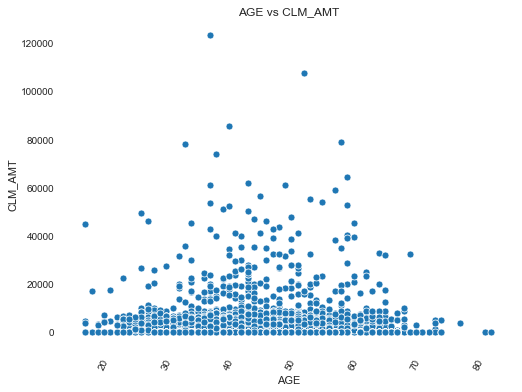

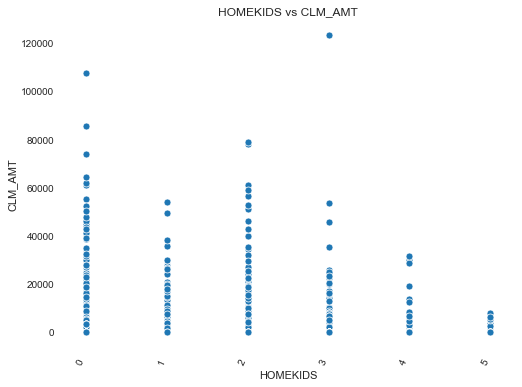

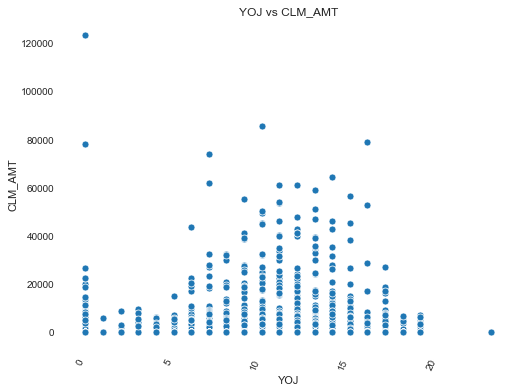

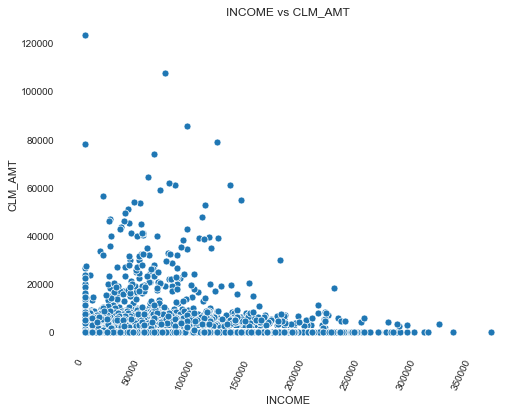

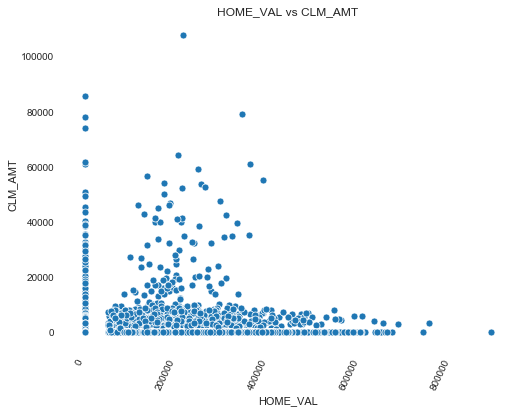

...

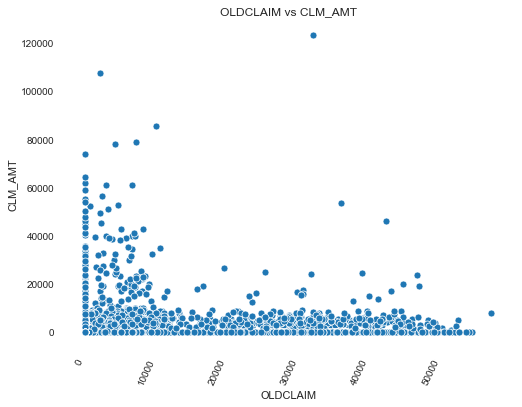

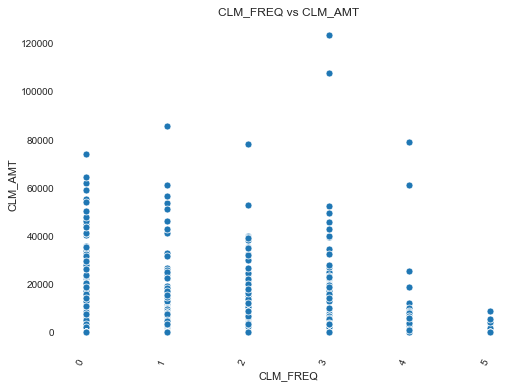

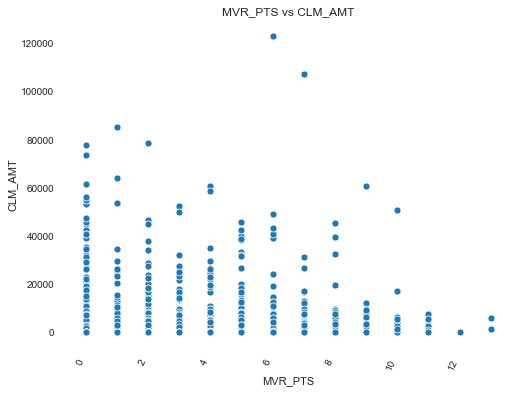

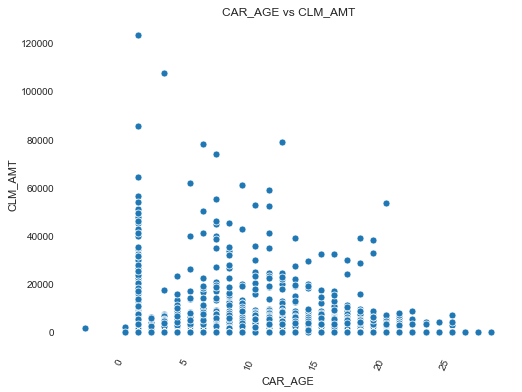

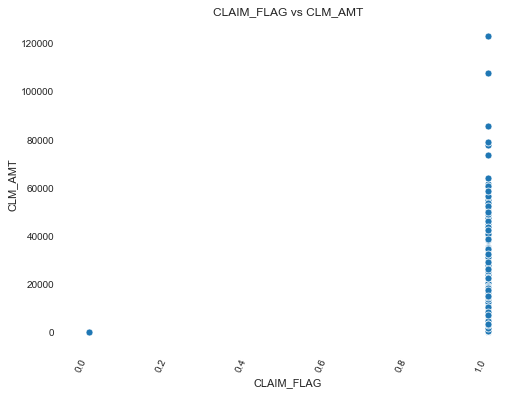

In [41]:
numcol_plot(carins,'CLM_AMT')

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


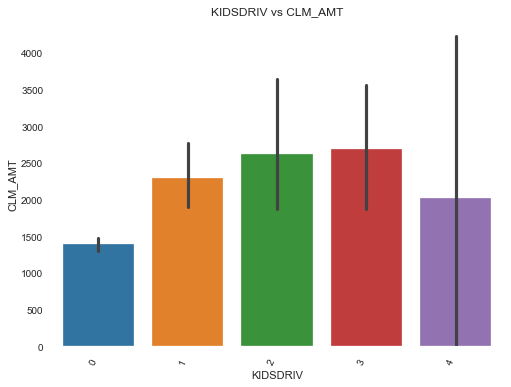

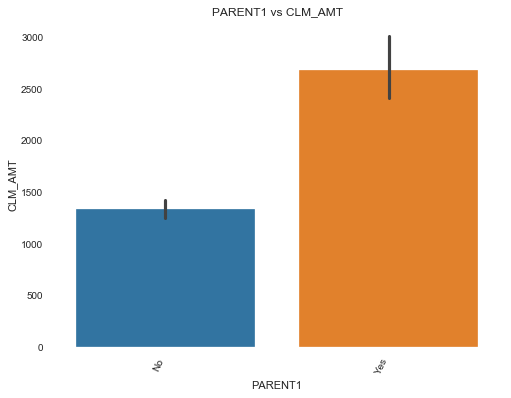

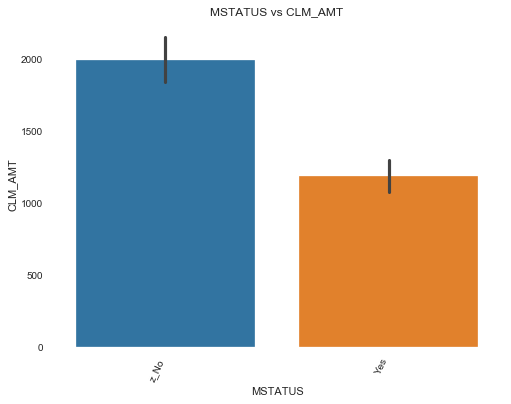

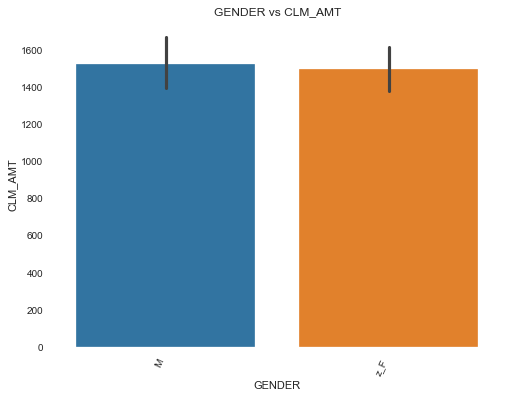

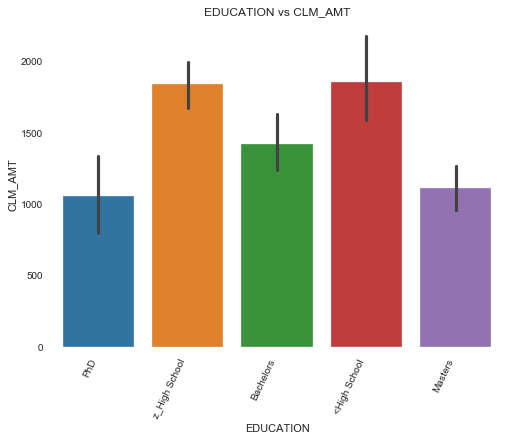

...

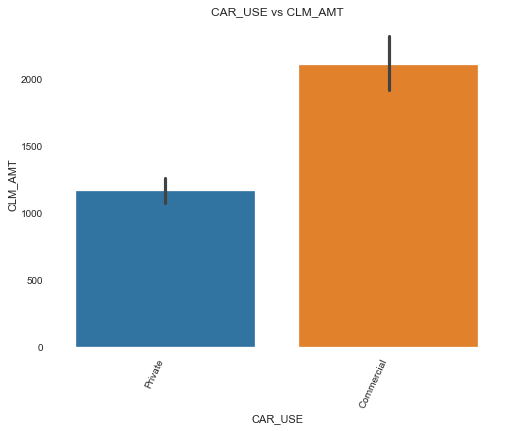

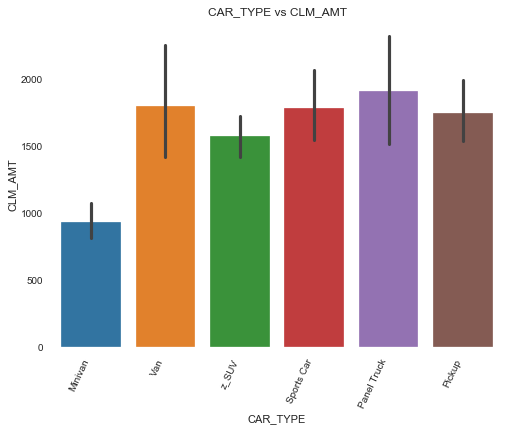

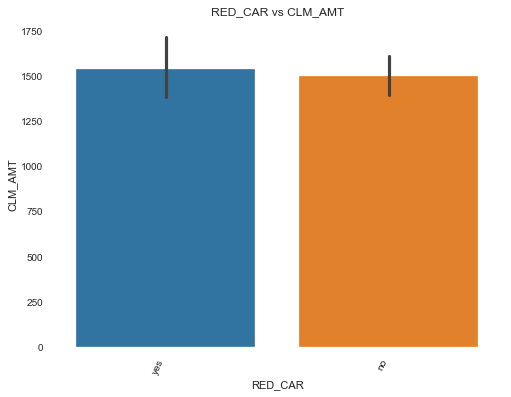

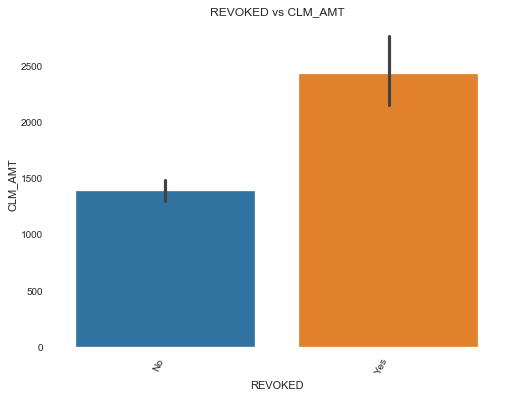

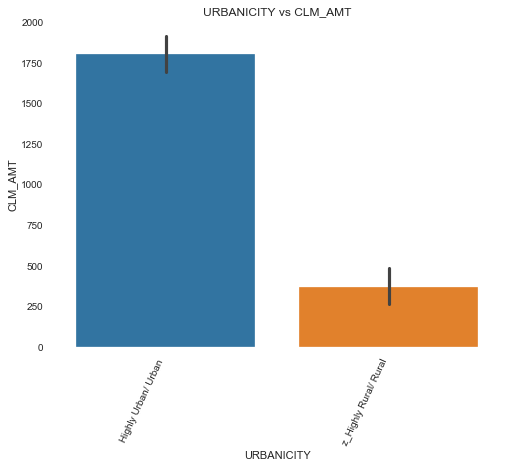

In [61]:
barCat_plot(carins,'CLM_AMT')

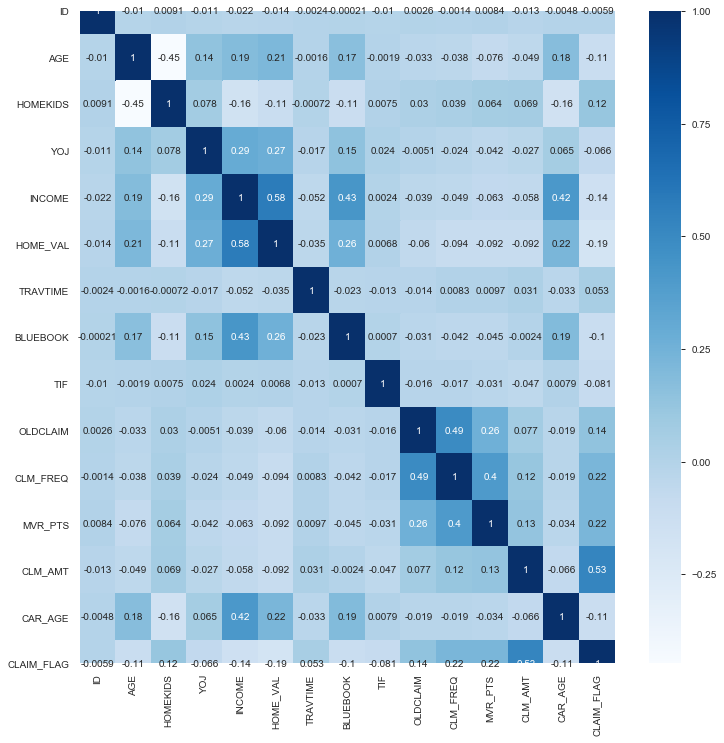

In [63]:
plt.figure(figsize=(12,12))
sns.heatmap(carins.corr(),cmap='Blues',annot = True,)
plt.show();

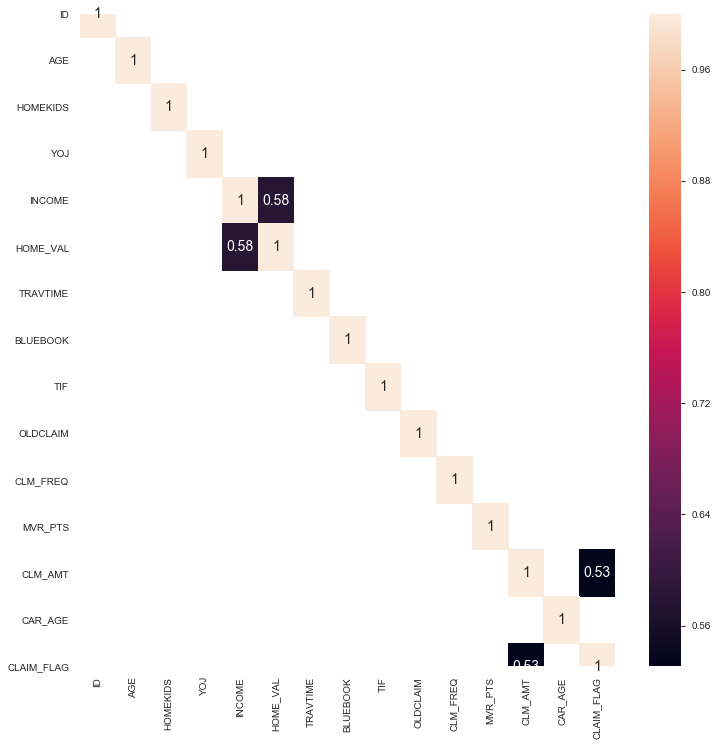

In [159]:
cars_corr2=carins.corr()
plt.figure(figsize=(12,12))
sns.heatmap(cars_corr2[(cars_corr2>=0.5)| (cars_corr2<=-0.5)],
            annot=True,annot_kws={"size":14});

### Dummifying the categorical variables


In [66]:
cat_cols=col_type(carins)[0]
cat_cols

Index(['KIDSDRIV', 'PARENT1', 'MSTATUS', 'GENDER', 'EDUCATION', 'OCCUPATION',
       'CAR_USE', 'CAR_TYPE', 'RED_CAR', 'REVOKED', 'URBANICITY'],
      dtype='object')

In [67]:
#Categorical variables dataframe
carcat_df=carins[cat_cols]

In [68]:
carcat_df.head()

,KIDSDRIV,PARENT1,MSTATUS,GENDER,EDUCATION,OCCUPATION,CAR_USE,CAR_TYPE,RED_CAR,REVOKED,URBANICITY
0,0,No,z_No,M,PhD,Professional,Private,Minivan,yes,No,Highly Urban/ Urban
1,0,No,z_No,M,z_High School,z_Blue Collar,Commercial,Minivan,yes,No,Highly Urban/ Urban
2,0,No,z_No,M,Bachelors,Manager,Private,Van,yes,No,Highly Urban/ Urban
3,0,No,Yes,z_F,z_High School,Clerical,Private,z_SUV,no,No,Highly Urban/ Urban
4,0,No,Yes,M,<High School,z_Blue Collar,Private,Minivan,yes,No,Highly Urban/ Urban


In [69]:
car_dummy=pd.get_dummies(carcat_df,drop_first=True)

In [70]:
car_dummy.shape

(10302, 27)

In [71]:
car_dummy.columns

Index(['KIDSDRIV_1', 'KIDSDRIV_2', 'KIDSDRIV_3', 'KIDSDRIV_4', 'PARENT1_Yes',
       'MSTATUS_z_No', 'GENDER_z_F', 'EDUCATION_Bachelors',
       'EDUCATION_Masters', 'EDUCATION_PhD', 'EDUCATION_z_High School',
       'OCCUPATION_Doctor', 'OCCUPATION_Home Maker', 'OCCUPATION_Lawyer',
       'OCCUPATION_Manager', 'OCCUPATION_Professional', 'OCCUPATION_Student',
       'OCCUPATION_z_Blue Collar', 'CAR_USE_Private', 'CAR_TYPE_Panel Truck',
       'CAR_TYPE_Pickup', 'CAR_TYPE_Sports Car', 'CAR_TYPE_Van',
       'CAR_TYPE_z_SUV', 'RED_CAR_yes', 'REVOKED_Yes',
       'URBANICITY_z_Highly Rural/ Rural'],
      dtype='object')

In [73]:
# Numeric columns to be concatenated to the above dumified columns
num_cols=col_type(carins)[1]
car_num=carins[num_cols]

In [74]:
car_num.columns

Index(['ID', 'AGE', 'HOMEKIDS', 'YOJ', 'INCOME', 'HOME_VAL', 'TRAVTIME',
       'BLUEBOOK', 'TIF', 'OLDCLAIM', 'CLM_FREQ', 'MVR_PTS', 'CLM_AMT',
       'CAR_AGE', 'CLAIM_FLAG'],
      dtype='object')

In [75]:
car_final=pd.concat([car_dummy,car_num],axis=1)

In [76]:
car_final.columns

Index(['KIDSDRIV_1', 'KIDSDRIV_2', 'KIDSDRIV_3', 'KIDSDRIV_4', 'PARENT1_Yes',
       'MSTATUS_z_No', 'GENDER_z_F', 'EDUCATION_Bachelors',
       'EDUCATION_Masters', 'EDUCATION_PhD', 'EDUCATION_z_High School',
       'OCCUPATION_Doctor', 'OCCUPATION_Home Maker', 'OCCUPATION_Lawyer',
       'OCCUPATION_Manager', 'OCCUPATION_Professional', 'OCCUPATION_Student',
       'OCCUPATION_z_Blue Collar', 'CAR_USE_Private', 'CAR_TYPE_Panel Truck',
       'CAR_TYPE_Pickup', 'CAR_TYPE_Sports Car', 'CAR_TYPE_Van',
       'CAR_TYPE_z_SUV', 'RED_CAR_yes', 'REVOKED_Yes',
       'URBANICITY_z_Highly Rural/ Rural', 'ID', 'AGE', 'HOMEKIDS', 'YOJ',
       'INCOME', 'HOME_VAL', 'TRAVTIME', 'BLUEBOOK', 'TIF', 'OLDCLAIM',
       'CLM_FREQ', 'MVR_PTS', 'CLM_AMT', 'CAR_AGE', 'CLAIM_FLAG'],
      dtype='object')

In [77]:
car_final.shape

(10302, 42)

## Train- Test Split

In [78]:
from sklearn.model_selection import train_test_split

In [94]:
y=car_final['CLM_AMT'] 

In [95]:
y.shape

(10302,)

In [96]:
X=car_final.drop(columns='CLM_AMT',axis=1)
X.shape

(10302, 41)

In [122]:
x_train,x_test,y_train,y_test = train_test_split(X,y,train_size=0.7,test_size=0.3,random_state=42)

In [123]:
x_train.shape

(7211, 41)

In [124]:
type(x_train)

pandas.core.frame.DataFrame

#### Imputing the numerical columns in train and test

In [125]:
#dataset.fillna(dataset.mean(), inplace=True)
x_train.fillna(x_train.mean(),inplace=True)

In [126]:
type(x_train_imp)

pandas.core.frame.DataFrame

In [128]:
x_test.fillna(x_test.mean(),inplace=True)

In [129]:
inspect_data(x_train)

,Data Type,Count of Blank Values,Count of Missing Values,% of Missing Values,No of Unique Data,Levels
KIDSDRIV_1,uint8,0,0,0.0,2,[0. 1.]
KIDSDRIV_2,uint8,0,0,0.0,2,[0. 1.]
KIDSDRIV_3,uint8,0,0,0.0,2,[0. 1.]
KIDSDRIV_4,uint8,0,0,0.0,2,[0. 1.]
PARENT1_Yes,uint8,0,0,0.0,2,[0. 1.]
MSTATUS_z_No,uint8,0,0,0.0,2,[0. 1.]
GENDER_z_F,uint8,0,0,0.0,2,[1. 0.]
EDUCATION_Bachelors,uint8,0,0,0.0,2,[0. 1.]
EDUCATION_Masters,uint8,0,0,0.0,2,[1. 0.]
EDUCATION_PhD,uint8,0,0,0.0,2,[0. 1.]


### Standardizing the numerical columns post train test split

In [139]:
car_num.columns

Index(['ID', 'AGE', 'HOMEKIDS', 'YOJ', 'INCOME', 'HOME_VAL', 'TRAVTIME',
       'BLUEBOOK', 'TIF', 'OLDCLAIM', 'CLM_FREQ', 'MVR_PTS', 'CLM_AMT',
       'CAR_AGE', 'CLAIM_FLAG'],
      dtype='object')

In [140]:
num_cols_lst = col_type(car_num)[1]

In [141]:
num_cols_lst=num_cols[1:]`

In [143]:
type(num_cols_lst)

pandas.core.indexes.base.Index

In [144]:
numeric_vars=['HOMEKIDS', 'YOJ', 'INCOME', 'HOME_VAL', 'TRAVTIME', 'BLUEBOOK', 'TIF',
       'OLDCLAIM', 'CLM_FREQ', 'MVR_PTS','CAR_AGE', 'CLAIM_FLAG']

In [136]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()

In [145]:
scaler.fit(x_train[numeric_vars])

StandardScaler(copy=True, with_mean=True, with_std=True)

In [146]:
#Standardizing train and val columns
x_train[numeric_vars] = scaler.transform(x_train[numeric_vars])
x_test[numeric_vars] = scaler.transform(x_test[numeric_vars])

# Modelling 

### Model 1 : Linear Regression

In [148]:
from sklearn.linear_model import LinearRegression

# Representing LinearRegression as lm(Creating LinearRegression Object)
lm = LinearRegression()
lm.fit(x_train,y_train)


LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [150]:
#Print coefficients and intercept
print("\nIntercept : ",lm.intercept_)

print("Coefficients :")
coeff_df = pd.DataFrame(lm.coef_,x_train.columns,columns=['Coefficient'])
coeff_df


Intercept :  1379.7729281903426
Coefficients :


,Coefficient
KIDSDRIV_1,1.190477e+02
KIDSDRIV_2,3.150015e+02
KIDSDRIV_3,-4.372850e+02
KIDSDRIV_4,-1.396454e+03
PARENT1_Yes,1.932335e+01
MSTATUS_z_No,2.551786e+02
GENDER_z_F,-2.587100e+02
EDUCATION_Bachelors,1.314516e+02
EDUCATION_Masters,2.198313e+02
EDUCATION_PhD,4.324615e+02


In [151]:
y_pred = lm.predict(x_test)

Text(0, 0.5, 'Fare Amount')

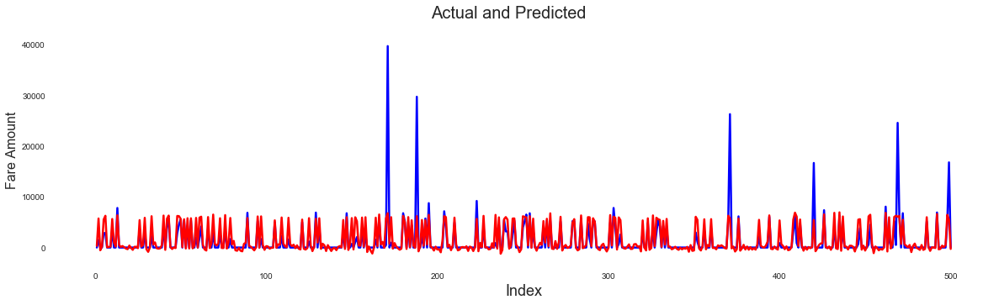

In [152]:
# Actual vs Predicted values for first 500 rows
import matplotlib.pyplot as plt
c = [i for i in range(1,501,1)]         # generating index 
fig = plt.figure(figsize=(20,5))
plt.plot(c,y_test.iloc[:500,], color="blue", linewidth=2.5, linestyle="-")
plt.plot(c,y_pred[:500,], color="red",  linewidth=2.5, linestyle="-")
fig.suptitle('Actual and Predicted', fontsize=20)              # Plot heading 
plt.xlabel('Index', fontsize=18)                               # X-label
plt.ylabel('Fare Amount', fontsize=16)    

Text(0, 0.5, 'y_test - y_pred')

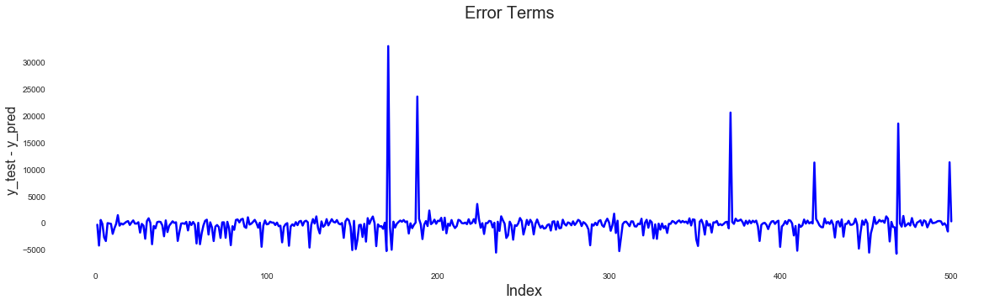

In [153]:
# Error terms
c = [i for i in range(1,501,1)]
fig = plt.figure(figsize=(20,5))
plt.plot(c,(y_test[:500,]-y_pred[:500,]), color="blue", linewidth=2.5, linestyle="-")
fig.suptitle('Error Terms', fontsize=20)              # Plot heading 
plt.xlabel('Index', fontsize=18)                      # X-label
plt.ylabel('y_test - y_pred', fontsize=16)   

In [156]:
from sklearn.metrics import mean_squared_error, r2_score
y_true=y_test
mse = mean_squared_error(y_test, y_pred)

r_squared = r2_score(y_test, y_pred)

print('Root Mean_Squared_Error :' ,np.sqrt(mse))
print('Mean_Squared_Error :' ,mse)
print('r_square_value :',r_squared)

Root Mean_Squared_Error : 2983.5903565590143
Mean_Squared_Error : 8901811.415751945
r_square_value : 0.34475850273682673


## Checking for p value using Stats Model

In [157]:
import statsmodels.api as sm
#Unlike SKLearn, statsmodels don't automatically fit a constant, 
#so you need to use the method sm.add_constant(X) in order to add a constant. 
X = sm.add_constant(x_train)
# create a fitted model in one line
lm_1 = sm.OLS(y_train,X).fit()
print(lm_1.summary())

                            OLS Regression Results                            
Dep. Variable:                CLM_AMT   R-squared:                       0.272
Model:                            OLS   Adj. R-squared:                  0.267
Method:                 Least Squares   F-statistic:                     65.17
Date:                Wed, 26 Aug 2020   Prob (F-statistic):               0.00
Time:                        11:53:27   Log-Likelihood:                -70656.
No. Observations:                7211   AIC:                         1.414e+05
Df Residuals:                    7169   BIC:                         1.417e+05
Df Model:                          41                                         
Covariance Type:            nonrobust                                         
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const   

# Linear Regression 2
 

We will be dropping some of the columns that are not that significant

In [ ]:
cols_drop =['Income','Occupation_Student','RED_CAR_yes']

In [163]:
cols=['MVR_PTS','CLAIM_FLAG','CAR_AGE','MSTATUS_z_No','BLUEBOOK']

In [164]:
train_x2 =x_train[cols]
train_x2.head()

,MVR_PTS,CLAIM_FLAG,CAR_AGE,MSTATUS_z_No,BLUEBOOK
164,-0.787739,-0.603037,1.402503,0,0.539278
6828,1.064208,1.658273,-1.315804,0,0.007087
2715,-0.787739,-0.603037,1.221283,1,0.035534
9190,0.601222,-0.603037,-0.228481,1,-0.981437
9735,-0.787739,1.658273,0.858842,0,2.778274


In [165]:
# Putting feature variable to Val X
test_x2 = x_test[cols]
test_x2.head()

,MVR_PTS,CLAIM_FLAG,CAR_AGE,MSTATUS_z_No,BLUEBOOK
3100,0.601222,-0.603037,-1.315804,0,0.547575
10109,-0.787739,1.658273,-0.047261,1,-0.544069
7445,-0.324752,-0.603037,-1.315804,1,-1.681939
7769,0.601222,-0.603037,1.946165,1,-1.065592
3305,0.601222,1.658273,-0.409702,1,-1.158044


In [166]:
import statsmodels.api as sm
#Unlike SKLearn, statsmodels don't automatically fit a constant, 
#so you need to use the method sm.add_constant(X) in order to add a constant. 
X2 = sm.add_constant(train_x2)
# create a fitted model in one line
lm_2 = sm.OLS(y_train,X2).fit()
print(lm_2.summary())

                            OLS Regression Results                            
Dep. Variable:                CLM_AMT   R-squared:                       0.269
Model:                            OLS   Adj. R-squared:                  0.268
Method:                 Least Squares   F-statistic:                     529.3
Date:                Wed, 26 Aug 2020   Prob (F-statistic):               0.00
Time:                        12:10:07   Log-Likelihood:                -70671.
No. Observations:                7211   AIC:                         1.414e+05
Df Residuals:                    7205   BIC:                         1.414e+05
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                   coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------
const         1509.9150     66.545     22.690   

In [167]:
from sklearn.linear_model import LinearRegression

# Representing LinearRegression as lm(Creating LinearRegression Object)
lm2 = LinearRegression()

# fit the model to the training data
lm2.fit(train_x2,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [168]:
y_pred2=lm2.predict(test_x2)

In [172]:
from sklearn.metrics import mean_squared_error, r2_score

y_true=y_test

mse_2 = mean_squared_error(y_true, y_pred2)

r_squared_2 = r2_score(y_true, y_pred2)

print('Root Mean_Squared_Error :' ,np.sqrt(mse_2))
print('Mean_Squared_Error :' ,mse_2)
print('r_square_value :',r_squared_2)

Root Mean_Squared_Error : 2970.002874724514
Mean_Squared_Error : 8820917.07587188
r_square_value : 0.3507129457043936


# ## Implementing RF based model

In [175]:
from sklearn.ensemble import RandomForestRegressor
rand_regr = RandomForestRegressor(n_estimators=400,random_state=0)
rand_regr.fit(x_train, y_train)
random=rand_regr.score(x_test,y_test)
predictions = rand_regr.predict(x_test)

In [176]:
y_true_rnd=y_test

mse = mean_squared_error(y_true_rnd, predictions)

r_squared = r2_score(y_true_rnd, predictions)

print('Root Mean_Squared_Error :' ,np.sqrt(mse))
print('Mean_Squared_Error :' ,mse)
print('r_square_value :',r_squared)

Root Mean_Squared_Error : 3305.4194590632483
Mean_Squared_Error : 10925797.800353976
r_square_value : 0.19577760355262563


In [178]:
rand_regr.feature_importances_

array([7.51375199e-03, 8.51854824e-03, 6.06335687e-04, 9.42889619e-07,
       1.21885054e-02, 5.73178482e-03, 3.55347570e-03, 7.40581509e-03,
       2.84761996e-03, 2.78900066e-03, 3.27871258e-03, 3.02433213e-04,
       5.62151535e-03, 1.69982217e-03, 1.21498254e-03, 9.63070074e-03,
       9.98792717e-03, 5.82557899e-03, 4.56542863e-03, 1.99795108e-03,
       4.63803711e-03, 1.07501182e-02, 6.07531005e-03, 5.56552889e-03,
       4.73546188e-03, 5.18404908e-03, 6.92681434e-03, 7.52264994e-02,
       4.98849173e-02, 1.29943088e-02, 3.39617626e-02, 6.00574415e-02,
       3.43699704e-02, 5.48122697e-02, 1.08693309e-01, 2.51224686e-02,
       4.98456490e-02, 2.52218922e-02, 3.44156341e-02, 2.87297145e-02,
       2.67508010e-01])

In [184]:
feature_imp_df = pd.DataFrame(x_train.columns,rand_regr.feature_importances_)

In [180]:
feature_imp_df

,0
7.513752e-03,KIDSDRIV_1
8.518548e-03,KIDSDRIV_2
6.063357e-04,KIDSDRIV_3
9.428896e-07,KIDSDRIV_4
1.218851e-02,PARENT1_Yes
5.731785e-03,MSTATUS_z_No
3.553476e-03,GENDER_z_F
7.405815e-03,EDUCATION_Bachelors
2.847620e-03,EDUCATION_Masters
2.789001e-03,EDUCATION_PhD


 ---- Further improvement in model would be obtained post doing hyperparameter tuning -----